In [1]:
from pyscf import gto, scf, dft

import pyscf.scf

import numpy as np

from ase.units import Bohr

import plotly.graph_objects as go

/home/sahre/opt/miniconda3/envs/qm-tools/lib/python3.9/site-packages/pyscf/lib/misc.py:46: H5pyDeprecationWarning: Using default_file_mode other than 'r' is deprecated. Pass the mode to h5py.File() instead.
  h5py.get_config().default_file_mode = 'a'


In [2]:
def eval_mo_pt(coords, mo_coeffs, mol):
    grid = np.array([coords])

    ao_vals = dft.numint.eval_ao(mol, grid)
    return((mo_coeffs*ao_vals).sum())

def eval_mo(grid, mo_coeffs, mol):
    ao_vals = dft.numint.eval_ao(mol, grid)
    mo_vals = (mo_coeffs*ao_vals).sum(axis=1)
    return(mo_vals)

In [3]:
mol = gto.Mole()
mol.verbose = 0
mol.atom = f'H 0 0 -0.5; F 0 0 0.5'
mol.basis = 'sto-3g'
mol.build()

calc = scf.RHF(mol)
calc.kernel()

-98.57048973900093

In [ ]:
mo_coeffs = calc.mo_coeff[:,0]
n_gpt = 50
x,y,z = np.meshgrid( np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt))
grid = np.array((x.flatten(), y.flatten(), z.flatten())).T
mo_vals = eval_mo(grid, mo_coeffs, mol)

In [ ]:
print(np.amin(mo_vals))
print(np.amax(mo_vals))

In [ ]:
n_gpt = 50
x,y,z = np.meshgrid( np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt))
grid = np.array((x.flatten(), y.flatten(), z.flatten())).T
mo_vals = eval_mo(grid, mo_coeffs, mol)
cs0=[(0.00, "#1f77b4"),   (0.33, "#1f77b4"), (0.33, "#1f77b4"), (0.66, "#1f77b4"), (0.66, "#1f77b4"),  (1.00, "#1f77b4")]

data0=go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=mo_vals,
    opacity = 0.6,
    isomin=0.25,
    isomax=0.25,
    surface_count=1,
    colorscale = cs0,
    caps=dict(x_show=False, y_show=False, z_show=False)
)

fig= go.Figure(data0)


nuclei = go.Scatter3d(
    x=np.array([0,0]), y=np.array([0,0]), z=np.array([-0.5,0.5]),
    marker=dict(
        size=4,
        color=z,
        colorscale='Viridis',
    ),
    line=dict(
        color='black',
        width=2
    )
)

fig.add_traces(nuclei)

fig.update_scenes(xaxis_visible=False, yaxis_visible=False, zaxis_visible=False)
fig.show()

In [ ]:
def sph2cart(r, phi, theta):
    x = r*np.sin(phi)*np.cos(theta)
    y = r*np.sin(phi)*np.sin(theta)
    z = r*np.cos(phi)
    return(x,y,z)

phi = np.linspace(0, 2*np.pi, 25)
theta = np.linspace(0, np.pi, 25)
r = 1

phi_g, theta_g = np.meshgrid(phi, theta)

x,y,z = sph2cart(r, phi_g, theta_g)

In [ ]:
np.amax(x)

In [ ]:
mo_coeffs = calc.mo_coeff[:,1]
n_gpt = 50
x,y,z = np.meshgrid( np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt))
grid = np.array((x.flatten(), y.flatten(), z.flatten())).T
mo_vals = eval_mo(grid, mo_coeffs, mol)

In [ ]:
cs2=[(0.00, "#ff7f0e"),   (0.33, "#ff7f0e"),(0.66, "#1f77b4"),  (1.00, "#1f77b4")]
fig= go.Figure(data=go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=mo_vals,
    opacity = 0.6,
    isomin=-0.25,
    isomax=0.25,
    surface_count=2,
    colorscale = cs2,
    caps=dict(x_show=False, y_show=False, z_show=False)
))

nuclei = go.Scatter3d(x=np.array([0,0]), y=np.array([0,0]), z=np.array([-0.5,0.5]), mode='markers',  line=dict(color='darkblue',
        width=2) )

fig.add_traces(nuclei)
fig.update_scenes(xaxis_visible=False, yaxis_visible=False, zaxis_visible=False)

fig.show()

In [11]:
np.amin(mix1)

-0.2014674419564854

In [12]:
np.amax(mix1)

0.24508844372367808

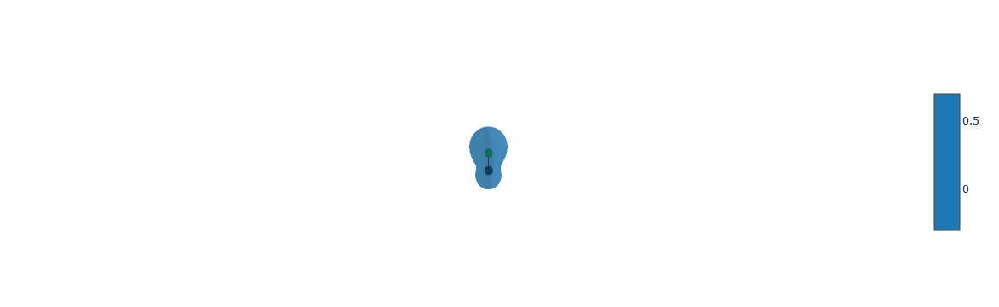

In [23]:
n_gpt = 50
x,y,z = np.meshgrid( np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt),  np.linspace(-1/Bohr, 1/Bohr, n_gpt))
grid = np.array((x.flatten(), y.flatten(), z.flatten())).T
H_1s = dft.numint.eval_ao(mol, grid)[:,0]
F_2s = dft.numint.eval_ao(mol, grid)[:,2]

mix0 = 0.5*(H_1s + F_2s)
mix1 = 0.5*(F_2s - H_1s)

cs0=[(0.00, "#1f77b4"),   (0.33, "#1f77b4"), (0.33, "#1f77b4"), (0.66, "#1f77b4"), (0.66, "#1f77b4"),  (1.00, "#1f77b4")]

cs1=[(0.00, "#ff7f0e"),   (0.33, "#ff7f0e"),(0.66, "#1f77b4"),  (1.00, "#1f77b4")]

data0=go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=mix0,
    opacity = 0.6,
    isomin=0.2,
    isomax=0.2,
    surface_count=1,
    colorscale = cs0,
    caps=dict(x_show=False, y_show=False, z_show=False)
)

data1=go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=mix1,
    opacity = 0.6,
    isomin=-0.2,
    isomax=0.2,
    surface_count=2,
    colorscale = cs1,
    caps=dict(x_show=False, y_show=False, z_show=False)
)

fig= go.Figure(data0)
#fig= go.Figure(data1)


nuclei = go.Scatter3d(
    x=np.array([0,0]), y=np.array([0,0]), z=np.array([-0.5,0.5]),
    marker=dict(
        size=6,
        color=['black', 'green']
    ),
    line=dict(
        color='black',
        width=2
    )
)

fig.add_traces(nuclei)

fig.update_scenes(xaxis_visible=False, yaxis_visible=False, zaxis_visible=False)
fig.show()